<a href="https://colab.research.google.com/github/EvertonTetila/WEED2C-Dataset/blob/main/WEED_detection_v3_YOLOv9.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Visão Computacional e Deep Learning para Sensoriamento Remoto com Python

#Projeto - Detecção de plantas daninhas por espécie na soja usando imagens de drones com a YOLOv9

## Implementando

Primeiro vamos instalar algumas bilbiotecas, importá-las e conectar com o Google Drive:

In [ ]:
!pip install rasterio
!pip install geopandas

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.5/21.5 MB 27.9 MB/s eta 0:00:00


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import rasterio
import geopandas as gpd
import numpy as np
from matplotlib import pyplot as plt
import cv2
from rasterio.features import rasterize
from rasterio.windows import Window
from rasterio.plot import show
import os
from shapely.geometry import box
from shapely.ops import unary_union
import json
from shapely.geometry import shape
from shapely.geometry import Polygon
from shapely.geometry import MultiPolygon
from shapely.ops import unary_union
import shapely
import math
import pandas as pd
from skimage import io
from skimage.io import imsave
from sklearn import model_selection
import os
import shutil
import json
import ast
import numpy as np
from tqdm import tqdm
import pandas as  pd
import seaborn as sns
import fastai.vision as vision
import xml.etree.ElementTree as ET
import glob
from skimage import io
from skimage.io import imsave

Vamos importar a base de dados WEED2C-Dataset para treinamento:

In [ ]:
path_train = '/content/drive/MyDrive/Datasets/WEED2C-Dataset/train'

In [ ]:
xml_files_train = [f for f in os.listdir(path_train) if f.endswith('xml')]

In [ ]:
xml_list_train = []
for xml_file in xml_files_train:
  tree = ET.parse(os.path.join(path_train,xml_file))
  root = tree.getroot()
  for member in root.findall('object'):
    value = (root.find('filename').text,
              int(root.find('size')[0].text),
              int(root.find('size')[1].text),
              member[0].text,
              int(member[4][0].text),
              int(member[4][1].text),
              int(member[4][2].text),
              int(member[4][3].text)
              )
    xml_list_train.append(value)
column_name = ['filename', 'width', 'height', 'classname', 'xmin', 'xmax', 'ymin', 'ymax']
xml_df_train = pd.DataFrame(xml_list_train, columns=column_name)

In [ ]:
xml_df_train

In [ ]:
list_of_image_train = [f for f in os.listdir(path_train) if f.endswith('jpg')]

Vamos plotar um exemplo:

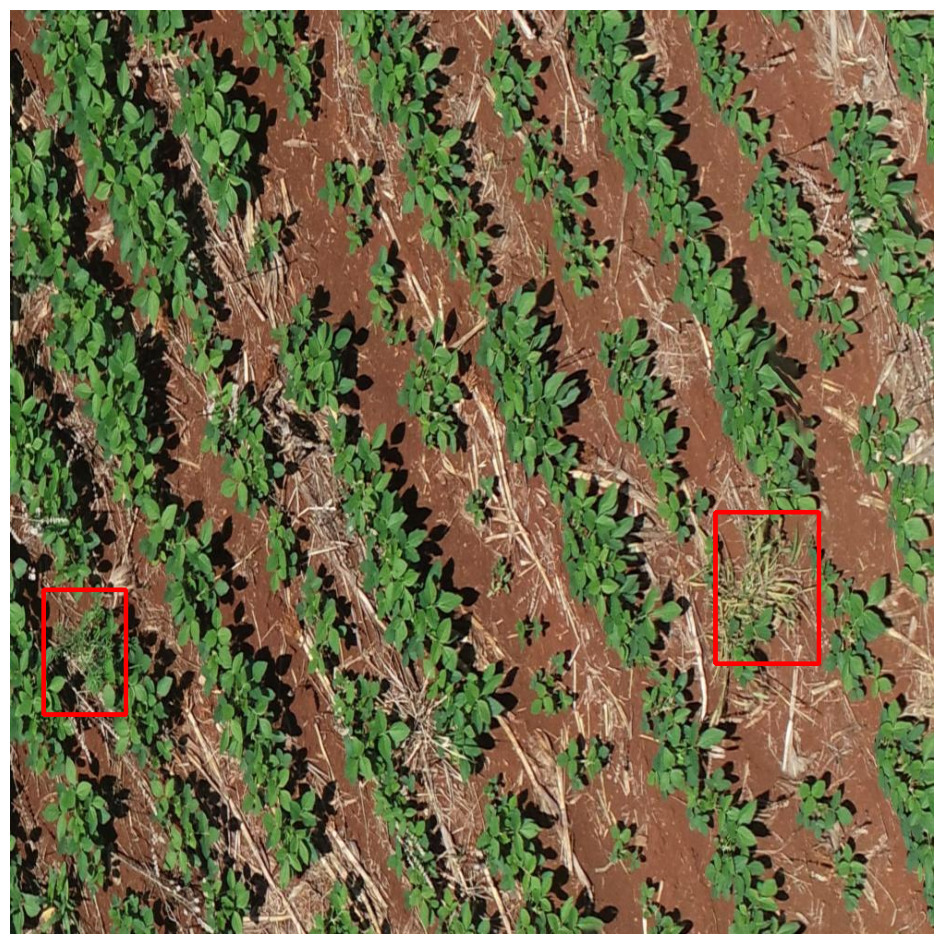

In [ ]:
i = 10
img = io.imread(os.path.join(path_train,list_of_image_train[i]))
detec = xml_df_train[xml_df_train['filename'] == list_of_image_train[i]]
for i, row in detec.iterrows():
  color = (255,0,0)
  cv2.rectangle(img, (max(0, row['xmin']), max(0, row['ymin']) , max(0, row['xmax'] - row['xmin']), max(0, row['ymax'] - row['ymin'])), color, 3)
plt.figure(figsize=(12,12))
plt.imshow(img)
plt.axis('off')
plt.show()

Agora importamos as bases de dados de validação:

In [ ]:
path_val = '/content/drive/MyDrive/Datasets/WEED2C-Dataset/validation'

In [ ]:
xml_files_val = [f for f in os.listdir(path_val) if f.endswith('xml')]
list_of_image_val = [f for f in os.listdir(path_val) if f.endswith('jpg')]
xml_list_val = []
for xml_file in xml_files_val:
  tree = ET.parse(os.path.join(path_val,xml_file))
  root = tree.getroot()
  for member in root.findall('object'):
    value = (root.find('filename').text,
              int(root.find('size')[0].text),
              int(root.find('size')[1].text),
              member[0].text,
              int(member[4][0].text),
              int(member[4][1].text),
              int(member[4][2].text),
              int(member[4][3].text)
              )
    xml_list_val.append(value)
column_name = ['filename', 'width', 'height', 'classname', 'xmin', 'xmax', 'ymin', 'ymax']
xml_df_val = pd.DataFrame(xml_list_val, columns=column_name)
xml_df_val

Adicionamos o id da classe que temos em nosso dataset:

In [ ]:
train_df = xml_df_train
valid_df = xml_df_val

In [ ]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
le.fit(train_df['classname'])
train_df['class'] = le.transform(train_df['classname'])
valid_df['class'] = le.transform(valid_df['classname'])

In [ ]:
train_df

Agora vamos copiar as imagens que estão no Drive para pastas no Content do Colab:

In [ ]:
path_data_train = 'train'
path_data_valid = 'validation'

if not os.path.isdir(path_data_train):
    os.mkdir(path_data_train)
if not os.path.isdir(path_data_valid):
    os.mkdir(path_data_valid)

In [ ]:
for images in list_of_image_train:
  img = io.imread(os.path.join(path_train,images))
  imsave(os.path.join(path_data_train,images.split('.')[0] + '.jpg'), img)

In [ ]:
for images in list_of_image_val:
  img = io.imread(os.path.join(path_val,images))
  imsave(os.path.join(path_data_valid,images.split('.')[0] + '.jpg'), img)

A partir das colunas de xmin, ymin, xmax e ymax, vamos obter os bounds:

In [ ]:
def getBounds(df):
    try:
        xmin = df['xmin']
        ymin = df['ymin']
        xmax = df['xmax']
        ymax = df['ymax']
        return (xmin, ymin, xmax, ymax)
    except:
        return np.nan

def getWidth(bounds):
    try:
        (xmin, ymin, xmax, ymax) = bounds
        return np.abs(xmax - xmin)
    except:
        return np.nan

def getHeight(bounds):
    try:
        (xmin, ymin, xmax, ymax) = bounds
        return np.abs(ymax - ymin)
    except:
        return np.nan

In [ ]:
train_df['bounds'] = train_df.apply(getBounds, axis=1)
train_df.loc[:,'width'] = train_df.loc[:,'bounds'].apply(getWidth)
train_df.loc[:,'height'] = train_df.loc[:,'bounds'].apply(getHeight)
train_df.head(10)

In [ ]:
valid_df['bounds'] = valid_df.apply(getBounds, axis=1)
valid_df.loc[:,'width'] = valid_df.loc[:,'bounds'].apply(getWidth)
valid_df.loc[:,'height'] = valid_df.loc[:,'bounds'].apply(getHeight)
valid_df.head(10)

,filename,width,height,classname,xmin,xmax,ymin,ymax,class,bounds
0,08-12-2020-v1-121-_jpg.rf.87060fd44712edaf7943...,61,87,buva,2,63,914,1001,0,"(2, 914, 63, 1001)"
1,08-12-2020-v1-121-_jpg.rf.87060fd44712edaf7943...,37,125,buva,2,39,451,576,0,"(2, 451, 39, 576)"
2,08-12-2020-v1-121-_jpg.rf.87060fd44712edaf7943...,76,150,capim_amargoso,873,949,657,807,1,"(873, 657, 949, 807)"
3,08-12-2020-v1-121-_jpg.rf.87060fd44712edaf7943...,68,155,capim_amargoso,933,1001,148,303,1,"(933, 148, 1001, 303)"
4,08-12-2020-v1-121-_jpg.rf.87060fd44712edaf7943...,45,106,capim_amargoso,956,1001,10,116,1,"(956, 10, 1001, 116)"
5,08-12-2020-v1-121-_jpg.rf.87060fd44712edaf7943...,56,102,buva,668,724,36,138,0,"(668, 36, 724, 138)"
6,08-12-2020-v1-121-_jpg.rf.87060fd44712edaf7943...,68,115,buva,585,653,2,117,0,"(585, 2, 653, 117)"
7,08-12-2020-v1-110-_jpg.rf.d40d70d27aea9ab8e49c...,81,160,capim_amargoso,437,518,833,993,1,"(437, 833, 518, 993)"
8,08-12-2020-v1-110-_jpg.rf.d40d70d27aea9ab8e49c...,86,187,buva,541,627,195,382,0,"(541, 195, 627, 382)"
9,08-12-2020-v1-103-_jpg.rf.a4de46450f6f1efafae5...,74,110,capim_amargoso,44,118,844,954,1,"(44, 844, 118, 954)"


Vamos salvar os dataframes de treinamento e validação em arquivos .csv:

In [ ]:
def convert(data, data_type):
    df = data.groupby('filename')['bounds'].apply(list).reset_index(name='bboxes')
    df['classes'] = data.groupby('filename')['class'].apply(list).reset_index(drop=True)
    df.to_csv(data_type + '.csv', index=False)
    print(data_type)
    print(df.shape)
    print(df.head())

df_train = convert(train_df, '/content/train')
df_valid = convert(valid_df, '/content/validation')

/content/train
(534, 3)
                                            filename  \
0  08-12-2020-v1-100-_jpg.rf.d2820d7755f1560450c0...   
1  08-12-2020-v1-102-_jpg.rf.3fefa75061e0bf2ded04...   
2  08-12-2020-v1-105-_jpg.rf.ba3bf5ca03922469f459...   
3  08-12-2020-v1-106-_jpg.rf.c45c0e9e39bd3763108f...   
4  08-12-2020-v1-107-_jpg.rf.27cf46c759e72901eeb5...   

                                              bboxes                classes  
0  [(432, 501, 481, 585), (491, 629, 525, 685), (...              [0, 0, 0]  
1  [(176, 831, 269, 975), (42, 652, 170, 854), (2...  [1, 0, 1, 1, 0, 0, 0]  
2  [(343, 745, 406, 843), (835, 402, 902, 507), (...              [1, 1, 1]  
3  [(419, 310, 497, 454), (609, 247, 693, 370), (...     [1, 0, 1, 1, 0, 0]  
4          [(815, 92, 905, 257), (606, 2, 705, 106)]                 [1, 1]  
/content/validation
(153, 3)
                                            filename  \
0  08-12-2020-v1-103-_jpg.rf.a4de46450f6f1efafae5...   
1  08-12-2020-v1-104-_jpg.rf.3

In [ ]:
import os
HOME = os.getcwd()
print(HOME)

/content


Para treinar a YOLOv9 baixamos sua implementação do github e instalamos seus requerimentos:

In [ ]:
!git clone https://github.com/SkalskiP/yolov9.git
%cd yolov9
!pip install -r requirements.txt -q

Cloning into 'yolov9'...
remote: Enumerating objects: 325, done.
remote: Counting objects: 100% (325/325), done.
remote: Compressing objects: 100% (152/152), done.
remote: Total 325 (delta 165), reused 264 (delta 162), pack-reused 0
Receiving objects: 100% (325/325), 2.23 MiB | 7.43 MiB/s, done.
Resolving deltas: 100% (165/165), done.
/content/yolov9
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.3/207.3 kB 4.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 9.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 34.7 MB/s eta 0:00:00


In [ ]:
from IPython.display import Image

In [ ]:
!mkdir -p {HOME}/weights

In [ ]:
!wget -P {HOME}/weights -q https://github.com/WongKinYiu/yolov9/releases/download/v0.1/yolov9-c.pt
!wget -P {HOME}/weights -q https://github.com/WongKinYiu/yolov9/releases/download/v0.1/yolov9-e.pt
!wget -P {HOME}/weights -q https://github.com/WongKinYiu/yolov9/releases/download/v0.1/gelan-c.pt
!wget -P {HOME}/weights -q https://github.com/WongKinYiu/yolov9/releases/download/v0.1/gelan-e.pt

In [ ]:
!ls -la {HOME}/weights

total 402440
drwxr-xr-x 2 root root      4096 Apr 27 22:41 .
drwxr-xr-x 1 root root      4096 Apr 27 22:40 ..
-rw-r--r-- 1 root root  51508261 Feb 18 12:36 gelan-c.pt
-rw-r--r-- 1 root root 117203713 Feb 18 12:36 gelan-e.pt
-rw-r--r-- 1 root root 103153312 Feb 18 12:36 yolov9-c.pt
-rw-r--r-- 1 root root 140217688 Feb 18 12:36 yolov9-e.pt


In [ ]:
%cd yolov9
!ls

[Errno 2] No such file or directory: 'yolov9'
/content/yolov9
benchmarks.py  export.py   panoptic	     segment	      utils
classify       figure	   README.md	     train_dual.py    val_dual.py
data	       hubconf.py  requirements.txt  train.py	      val.py
detect.py      models	   scripts	     train_triple.py  val_triple.py


Dentro da pasta principal da yolov9 criamos uma pasta para receber as nossas imagens e anotações:

In [ ]:
!mkdir plant_data
%cd plant_data

/content/yolov9/plant_data


E dentro desta pasta criamos diretórios para imagens e para os labels:

In [ ]:
!mkdir images
!mkdir labels
%cd images
!mkdir train
!mkdir validation
%cd ..
%cd labels
!mkdir train
!mkdir validation
%cd ..
%cd ..
%cd ..

/content/yolov9/plant_data/images
/content/yolov9/plant_data
/content/yolov9/plant_data/labels
/content/yolov9/plant_data
/content/yolov9
/content


In [ ]:
for root,dir,_ in os.walk('yolov9/plant_data'):
    print(root)
    print(dir)

yolov9/plant_data
['images', 'labels']
yolov9/plant_data/images
['validation', 'train']
yolov9/plant_data/images/validation
[]
yolov9/plant_data/images/train
[]
yolov9/plant_data/labels
['validation', 'train']
yolov9/plant_data/labels/validation
[]
yolov9/plant_data/labels/train
[]


O proximo passo é copiar as imagens de treinamento e validação para seus respectivos diretórios na pasta que criamos. Também vamos abrir os arquivos .csv de treinamento e validação e para cada imagem criaremos um .txt com as anotações pertencentes à imagem. Os valores de bounds serão normalizados, e alimentaremos o modelo com os valores de x e y centrais, altura e largura.

In [ ]:
INPUT_PATH = '/content/'
OUTPUT_PATH = '/content/yolov9/plant_data'
def process_data(data, data_type='train'):
    for _, row in tqdm(data.iterrows(), total = len(data)):
        image_name = row['filename'].split('.')[0]
        bounding_boxes = row['bboxes']
        classes = row['classes']
        yolo_data = []
        for bbox, Class in zip(bounding_boxes, classes):

            x_min = bbox[0]
            y_min = bbox[1]
            x_max = bbox[2]
            y_max = bbox[3]

            '''x = x_min / 1000
            y = y_min / 1000
            width = (x_max - x_min) / 1000
            height = (y_max - y_min) / 1000
            print(Class, x, y, width, height)
            yolo_data.append([Class, x, y, width, height])'''

            x_center = (x_min + x_max) / 2.0 / 1000
            y_center = (y_min + y_max) / 2.0 / 1000
            x_extend = (x_max - x_min) / 1000
            y_extend = (y_max - y_min) / 1000
            print(Class, x_center, y_center, x_extend, y_extend)
            yolo_data.append([Class, x_center, y_center, x_extend, y_extend])

            ''''x = bbox[0]
            y = bbox[1]
            w = bbox[2]
            h = bbox[3]
            x_center = x + w / 2
            y_center = y + h / 2

            x_center /= 1024
            y_center /= 1024
            w /= 1024
            h /= 1024
            yolo_data.append([Class, x_center, y_center, w, h])'''
        yoy_data = np.array(yolo_data)
        np.savetxt(
            os.path.join(OUTPUT_PATH, f"labels/{data_type}/{image_name}.txt"),
            yolo_data,
            fmt = ["%d", "%f", "%f", "%f", "%f"]
        )
        shutil.copyfile(
            os.path.join(INPUT_PATH, f"{data_type}/{image_name}.jpg"),
            os.path.join(OUTPUT_PATH, f"images/{data_type}/{image_name}.jpg")
        )

df_train = pd.read_csv('/content/train.csv')
df_train.bboxes = df_train.bboxes.apply(ast.literal_eval)
df_train.classes = df_train.classes.apply(ast.literal_eval)

df_valid = pd.read_csv('/content/validation.csv')
df_valid.bboxes = df_valid.bboxes.apply(ast.literal_eval)
df_valid.classes = df_valid.classes.apply(ast.literal_eval)

process_data(df_train, data_type='train')
process_data(df_valid, data_type='validation')

In [ ]:
f = open('/content/yolov9/plant_data/labels/train/'+os.listdir("/content/yolov9/plant_data/labels/train/")[0])
print(f.name)
for l in f:
    print(l)

/content/yolov9/plant_data/labels/train/08-12-2020-v1-136-_jpg.txt
1 0.114500 0.831000 0.109000 0.190000

1 0.416500 0.430000 0.085000 0.138000

1 0.906500 0.086000 0.079000 0.136000

1 0.515000 0.305000 0.132000 0.218000

1 0.429000 0.129500 0.072000 0.115000



Agora vamos configurar alguns arquivos da yolov9:

In [ ]:
%cd yolov9

/content/yolov9


Primeiro criamos o yaml com informações como caminhos das imagens, número de classe e nomes das classes.

In [ ]:
%%writefile plant.yaml

train: plant_data/images/train
val: plant_data/images/validation
nc: 2
names: ['Buva', 'capim_amargoso']

Writing plant.yaml


In [ ]:
%%writefile data/plant.names

plant

Writing data/plant.names


Para treinar o modelo com nossos dados, passamos algumas informações como tamanho da imagem, bath_size, o arquivo yaml com as informações, e a quantidade de épocas:

**Training from scratch**

When having a large enough dataset, the model will benefit most by training from scratch. The weights are randomly initialized by passing an empty string (' ') to the weights argument.

--weights ' '

**Everton, veja abaixo** 👇👇👇👇👇👇

In [ ]:
#!python train.py \
#--batch 8 --epochs 100 --img 1000 --device 0 --min-items 0 --close-mosaic 15 \
#--data plant.yaml \
#--weights {HOME}/weights/gelan-c.pt \
#--cfg models/detect/gelan-c.yaml \
#--hyp hyp.scratch-high.yaml

!python train.py \
--batch 8 --epochs 100 --img 1000 --device 0 --min-items 0 --close-mosaic 15 \
--data plant.yaml \
--weights '' \
--cfg models/detect/gelan-c.yaml \
--hyp hyp.scratch-high.yaml

2024-04-27 22:41:22.551323: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-04-27 22:41:22.551380: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-04-27 22:41:22.553335: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-04-27 22:41:23.753569: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
train: weights=/content/weights/gelan-c.pt, cfg=models/detect/gelan-c.yaml, data=plant.yaml, hyp=hyp.scratch-high.yaml, epochs=100, batch_size=8, imgsz=1000, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=Fa

Após finalizar o treinamento podemos ver algumas métricas:

In [ ]:
from IPython.display import Image, display

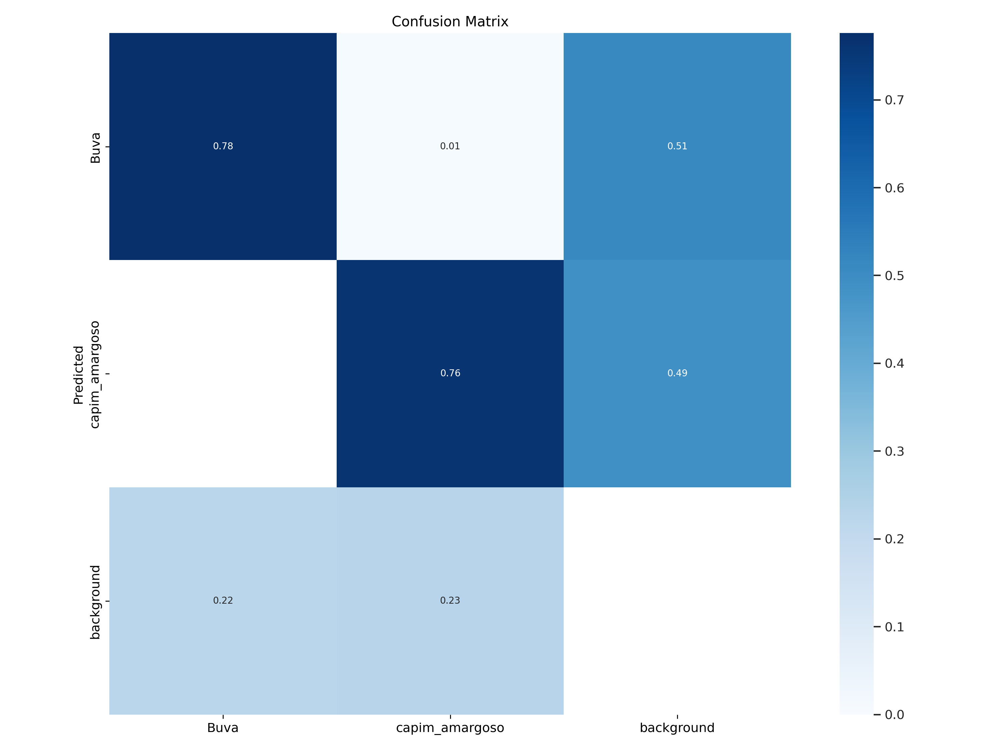

In [ ]:
Image(filename='/content/yolov9/runs/train/exp/confusion_matrix.png', width=900)

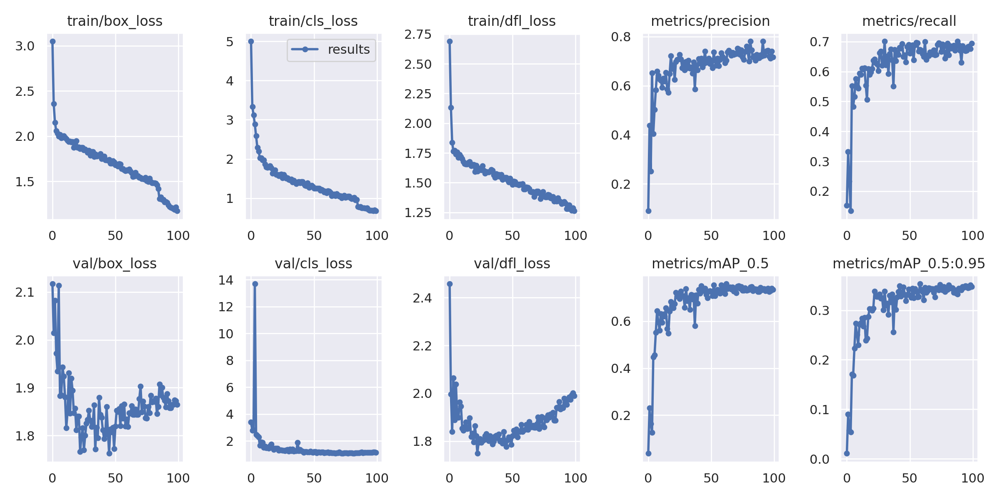

In [ ]:
Image(filename=f"{HOME}/yolov9/runs/train/exp/results.png", width=1000)

Também é possivel plotar as imagens usadas por lote de treinamento:

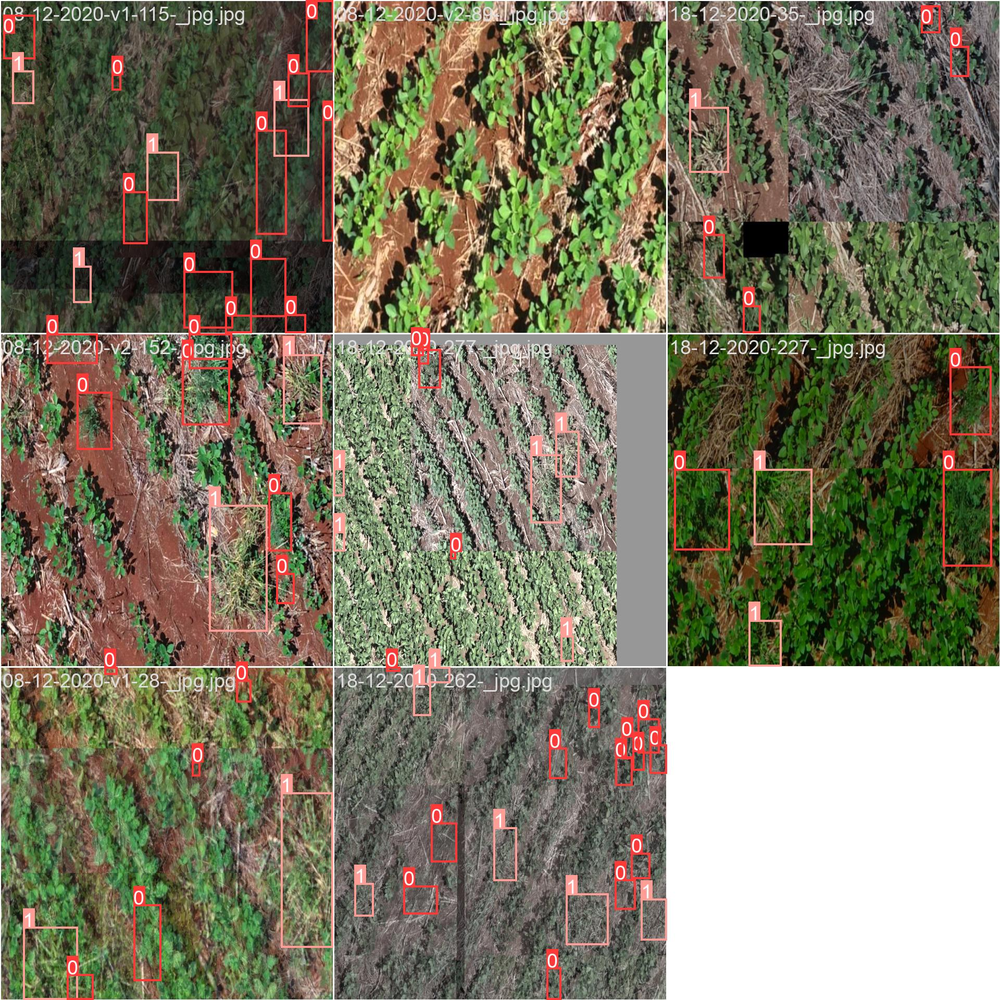

In [ ]:
Image(filename='/content/yolov9/runs/train/exp/train_batch0.jpg', width=900)

In [ ]:
!python val.py --img 1000 --batch 32 --conf 0.001 --iou 0.7 --device 0 --data plant.yaml --weights runs/train/exp/weights/best.pt

val: data=plant.yaml, weights=['runs/train/exp/weights/best.pt'], batch_size=32, imgsz=1000, conf_thres=0.001, iou_thres=0.7, max_det=300, task=val, device=0, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False, min_items=0
YOLOv5 🚀 1e33dbb Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
gelan-c summary: 467 layers, 25412502 parameters, 0 gradients, 102.5 GFLOPs
WARNING ⚠️ --img-size 1000 must be multiple of max stride 32, updating to 1024
val: Scanning /content/yolov9/plant_data/labels/validation.cache... 153 images, 0 backgrounds, 0 corrupt: 100% 153/153 [00:00<?, ?it/s]
val: WARNING ⚠️ /content/yolov9/plant_data/images/validation/08-12-2020-v1-103-_jpg.jpg: 7 duplicate labels removed
val: WARNING ⚠️ /content/yolov9/plant_data/images/validation/08-12-2020-v1-104-_jpg.jpg: 2 duplicate labels removed
val: WARNING ⚠

Por fim, podemos detectar nosso objeto alvo nas imagens de validação a fim de comparar os reultados e ver como ficaram as predições:

In [ ]:
!python detect.py --img 1000 --conf 0.25 --device 0 --weights runs/train/exp/weights/best.pt --source /content/validation --save-txt

detect: weights=['runs/train/exp/weights/best.pt'], source=/content/validation, data=data/coco128.yaml, imgsz=[1000, 1000], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=0, view_img=False, save_txt=True, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 1e33dbb Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
gelan-c summary: 467 layers, 25412502 parameters, 0 gradients, 102.5 GFLOPs
WARNING ⚠️ --img-size [1000, 1000] must be multiple of max stride 32, updating to [1024, 1024]
image 1/153 /content/validation/08-12-2020-v1-103-_jpg.jpg: 1024x1024 2 Buvas, 5 capim_amargosos, 94.2ms
image 2/153 /content/validation/08-12-2020-v1-104-_jpg.jpg: 1024x1024 1 Buva, 4 capim_amargosos, 76.5ms
image 3/153 /content/validation/08-12-2020-v1-

In [ ]:
print(sorted(os.listdir('/content/yolov9/runs/detect/exp4/')))

['08-12-2020-v1-103-_jpg.jpg', '08-12-2020-v1-104-_jpg.jpg', '08-12-2020-v1-109-_jpg.jpg', '08-12-2020-v1-110-_jpg.jpg', '08-12-2020-v1-113-_jpg.jpg', '08-12-2020-v1-118-_jpg.jpg', '08-12-2020-v1-121-_jpg.jpg', '08-12-2020-v1-140-_jpg.jpg', '08-12-2020-v1-141-_jpg.jpg', '08-12-2020-v1-142-_jpg.jpg', '08-12-2020-v1-143-_jpg.jpg', '08-12-2020-v1-144-_jpg.jpg', '08-12-2020-v1-154-_jpg.jpg', '08-12-2020-v1-16-_jpg.jpg', '08-12-2020-v1-166-_jpg.jpg', '08-12-2020-v1-171-_jpg.jpg', '08-12-2020-v1-183-_jpg.jpg', '08-12-2020-v1-205-_jpg.jpg', '08-12-2020-v1-207-_jpg.jpg', '08-12-2020-v1-209-_jpg.jpg', '08-12-2020-v1-21-_jpg.jpg', '08-12-2020-v1-212-_jpg.jpg', '08-12-2020-v1-218-_jpg.jpg', '08-12-2020-v1-220-_jpg.jpg', '08-12-2020-v1-225-_jpg.jpg', '08-12-2020-v1-23-_jpg.jpg', '08-12-2020-v1-231-_jpg.jpg', '08-12-2020-v1-234-_jpg.jpg', '08-12-2020-v1-238-_jpg.jpg', '08-12-2020-v1-244-_jpg.jpg', '08-12-2020-v1-245-_jpg.jpg', '08-12-2020-v1-250-_jpg.jpg', '08-12-2020-v1-252-_jpg.jpg', '08-12-2020-

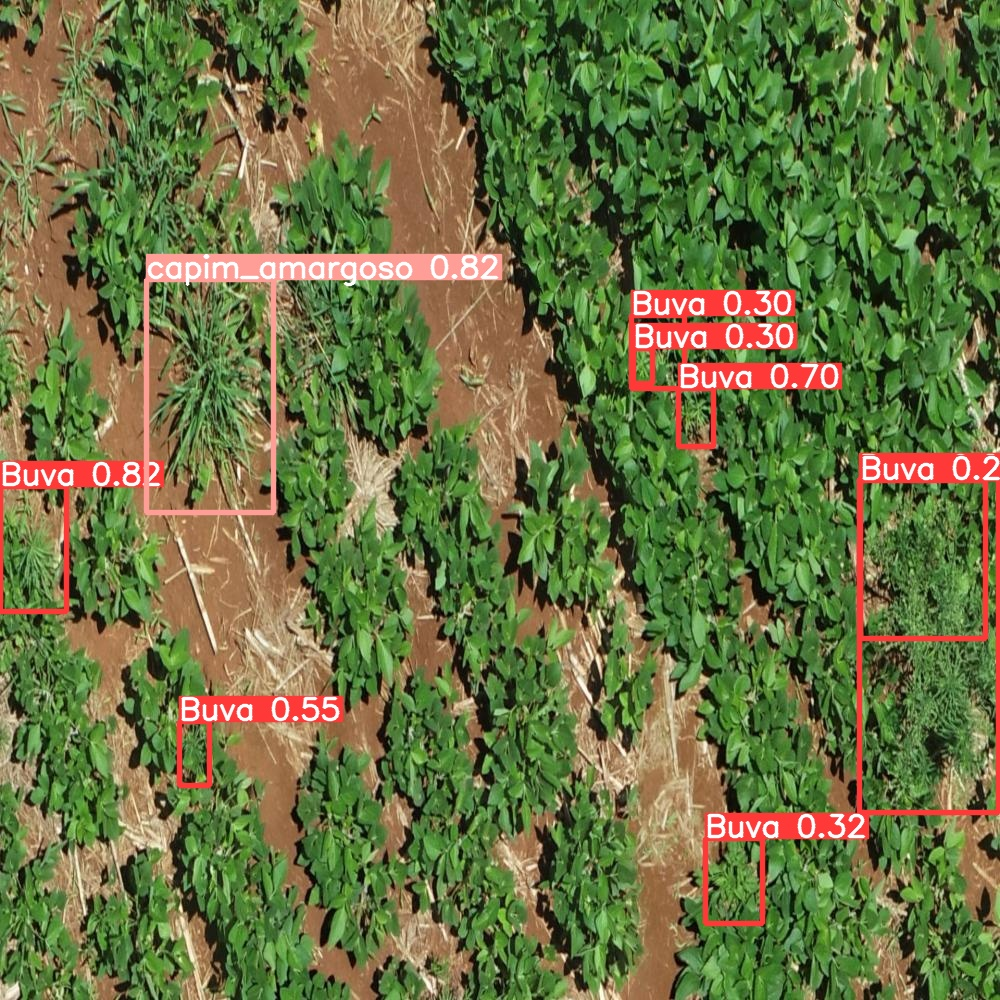

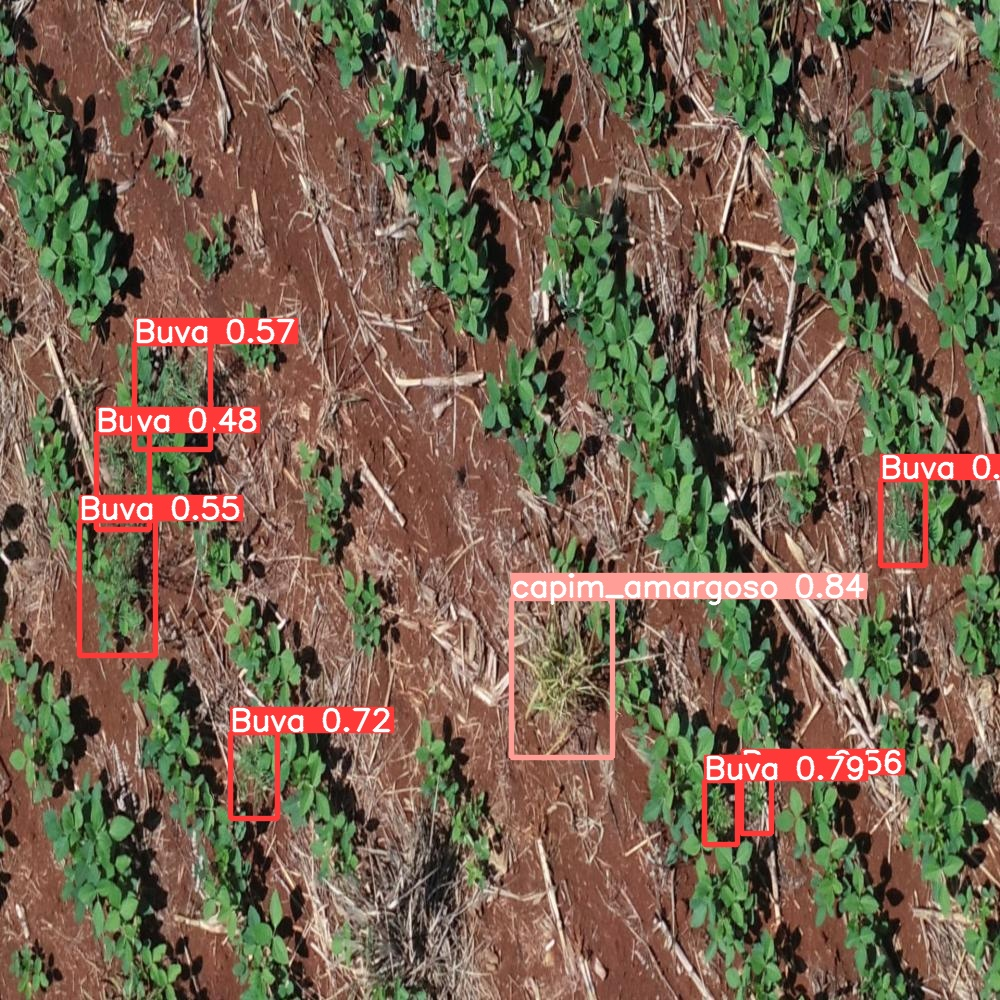

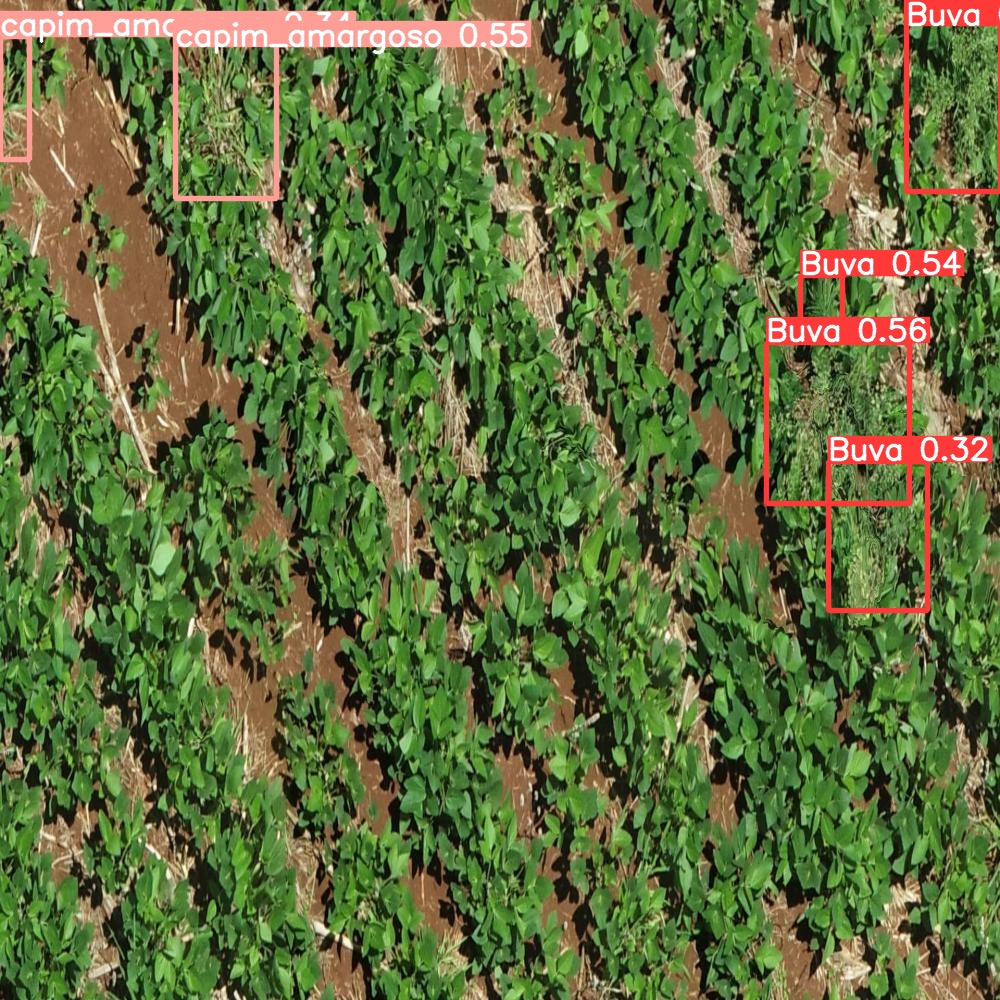

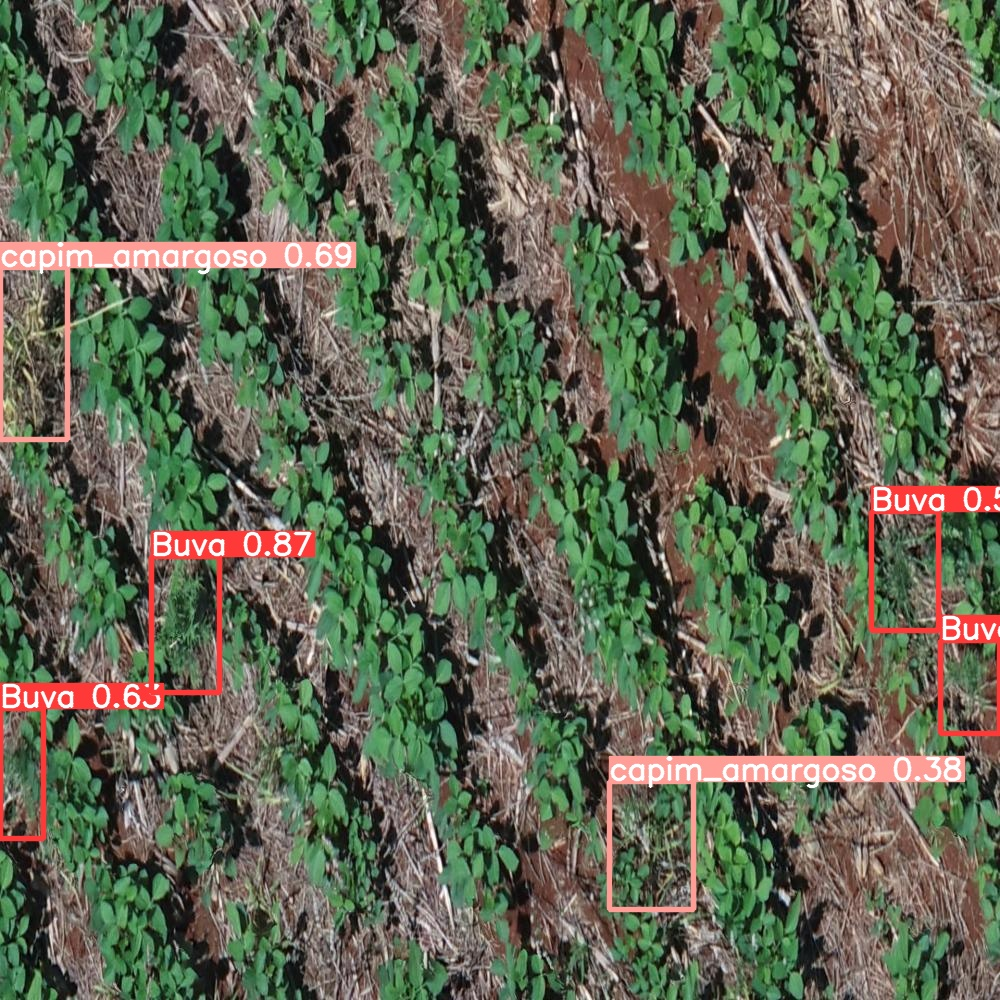

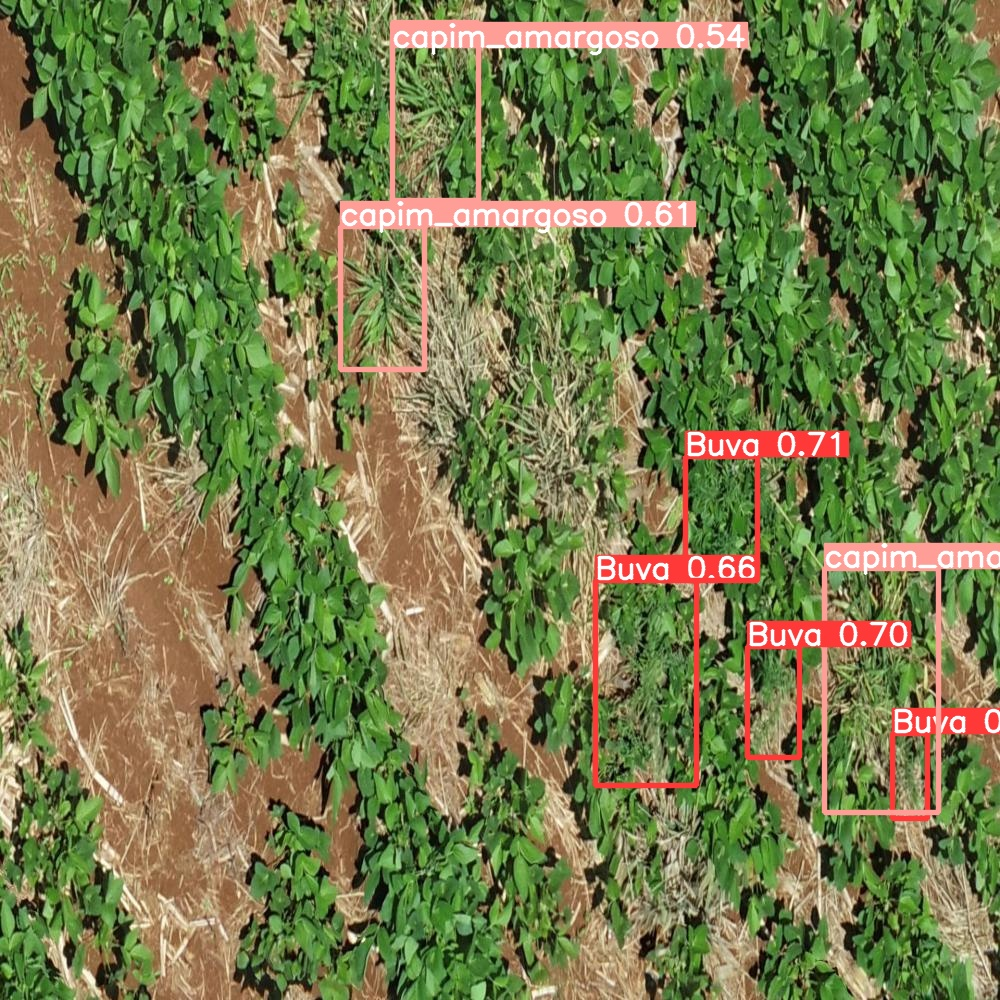

In [ ]:
for images in glob.glob('/content/yolov9/runs/detect/exp4/*.jpg')[0:5]:
    display(Image(filename=images))

Agora que temos nosso modelo treinado podemos aplicar a uma imagem completa. Vamos particionar essa imagem, realizar as detecções e depois converter esss detcções para pontos geolocalizados:

Iniciamos setando o caminho da imagem e abrindo ela:

In [ ]:
path_img = '/content/drive/MyDrive/Datasets/WEED2C-Dataset/ortomosaico-v3.tif'

In [ ]:
src_img = rasterio.open(path_img)

In [ ]:
img = src_img.read()

In [ ]:
img.shape

(4, 34622, 21903)

In [ ]:
img = img.transpose([1,2,0])

(-0.5, 21902.5, 34621.5, -0.5)

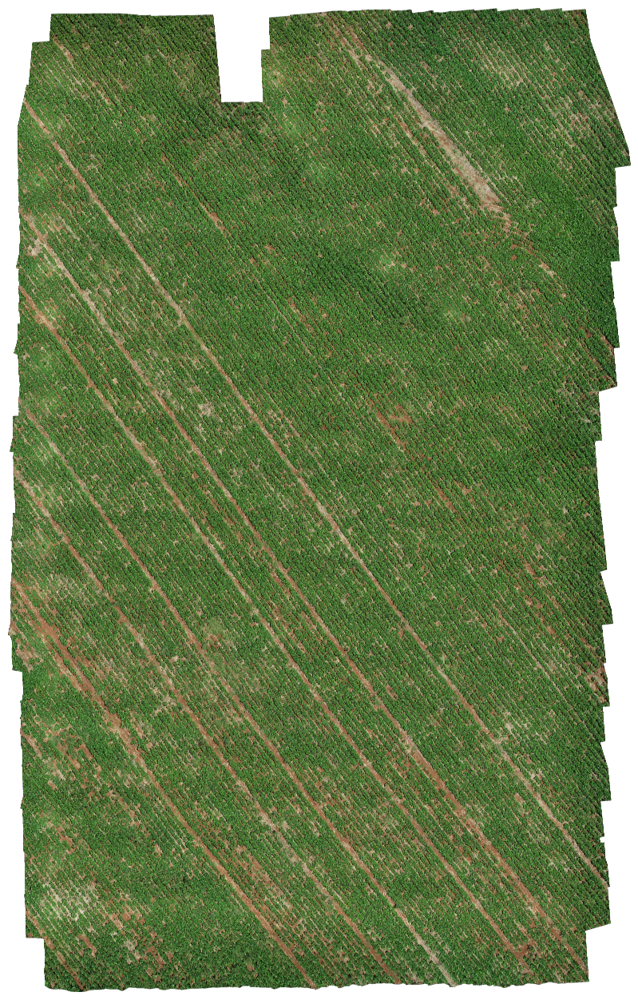

In [ ]:
plt.figure(figsize=[16,16])
plt.imshow(img)
plt.axis('off')

Agora vamos dividir a imagem em tamanhos iguais aos que treinamos:

In [ ]:
if not os.path.isdir('/content/Predict'):
    os.mkdir('/content/Predict')

In [ ]:
qtd = 0
out_meta = src_img.meta.copy()
for n in range((src_img.meta['width']//1000)):
  for m in range((src_img.meta['height']//1000)):
    x = (n*1000)
    y = (m*1000)
    window = Window(x,y,1000,1000)
    win_transform = src_img.window_transform(window)
    arr_win = src_img.read(window=window)
    arr_win = arr_win[0:3,:,:]
    if (arr_win.max() != 0) and (arr_win.shape[1] == 1000) and (arr_win.shape[2] == 1000):
      qtd = qtd + 1
      path_exp = '/content/Predict/img_' + str(qtd) + '.tif'
      out_meta.update({"driver": "GTiff","height": 1000,"width": 1000, "transform":win_transform})
      with rasterio.open(path_exp, 'w', **out_meta) as dst:
          for i, layer in enumerate(arr_win, start=1):
              dst.write_band(i, layer.reshape(-1, layer.shape[-1]))
      del arr_win

In [ ]:
print(qtd)

711


Agora abrimos cada uma das iamgens geradas e salvamos uma cópia em formato .JPG:



In [ ]:
if not os.path.isdir('/content/Predict_jpg'):
    os.mkdir('/content/Predict_jpg')

path_data_pred = '/content/Predict_jpg'
imgs_to_pred = os.listdir('/content/Predict')
for images in imgs_to_pred:
  src = rasterio.open('/content/Predict/' + images)
  raster = src.read()
  raster = raster.transpose([1,2,0])
  raster = raster[:,:,0:3]
  imsave(os.path.join(path_data_pred,images.split('.')[0] + '.jpg'), raster)

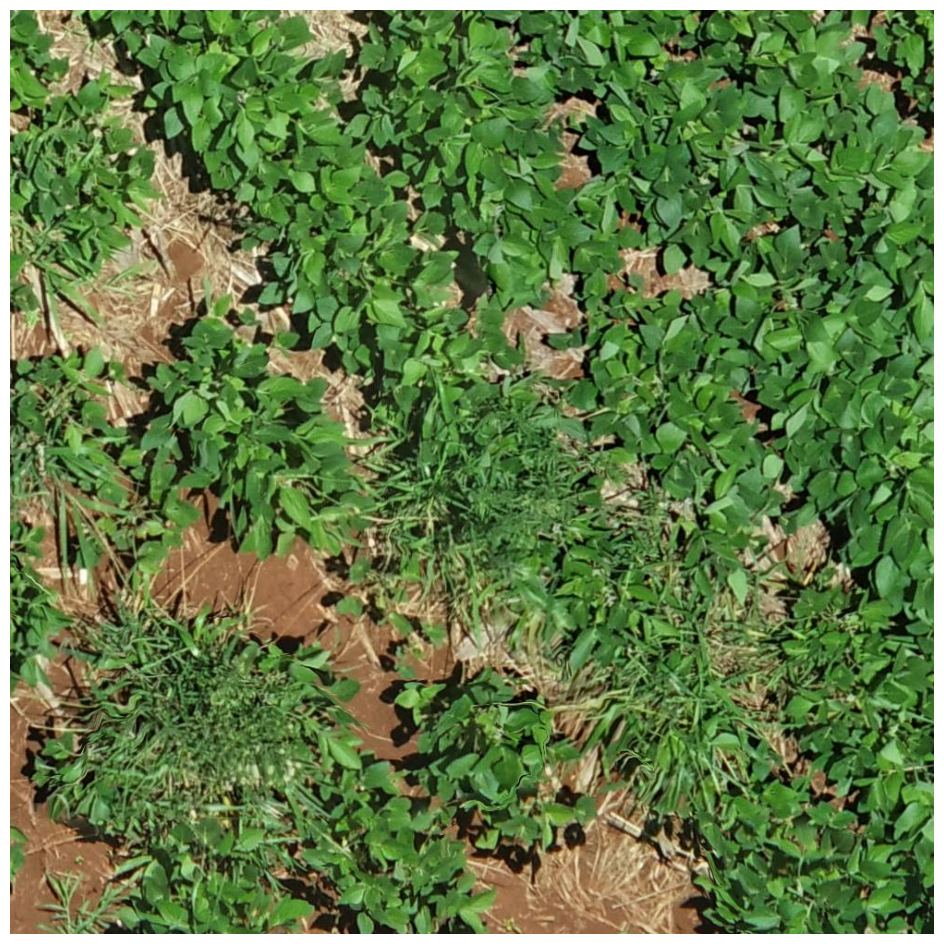

In [ ]:
img = io.imread('/content/Predict_jpg/img_92.jpg')
plt.figure(figsize=(12,12))
plt.imshow(img)
plt.axis('off')
plt.show()

E então aplicamos o predict passando o caminho da pasta de imagens .jpg. O resultado das detecções são arquivos .txt com os boundboxes.

In [ ]:
!python detect.py --weights runs/train/exp/weights/best.pt --device 0 --source /content/Predict_jpg --save-txt --conf 0.25

detect: weights=['runs/train/exp/weights/best.pt'], source=/content/Predict_jpg, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=0, view_img=False, save_txt=True, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 1e33dbb Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
gelan-c summary: 467 layers, 25412502 parameters, 0 gradients, 102.5 GFLOPs
image 1/711 /content/Predict_jpg/img_1.jpg: 640x640 (no detections), 51.7ms
image 2/711 /content/Predict_jpg/img_10.jpg: 640x640 (no detections), 46.1ms
image 3/711 /content/Predict_jpg/img_100.jpg: 640x640 2 Buvas, 46.1ms
image 4/711 /content/Predict_jpg/img_101.jpg: 640x640 6 Buvas, 41.1ms
image 5/711 /content/Predict_jpg/img_102.jpg: 640x640 1 Bu

Alguns resultados:

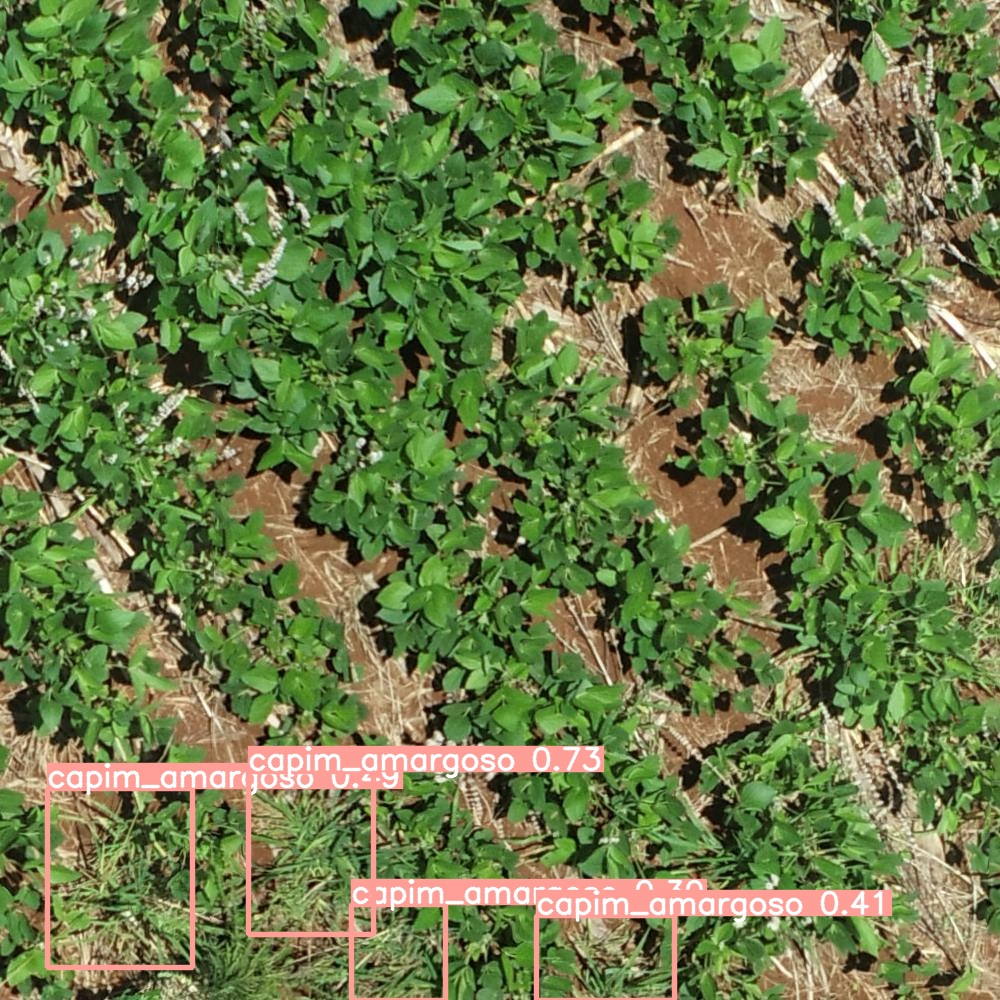

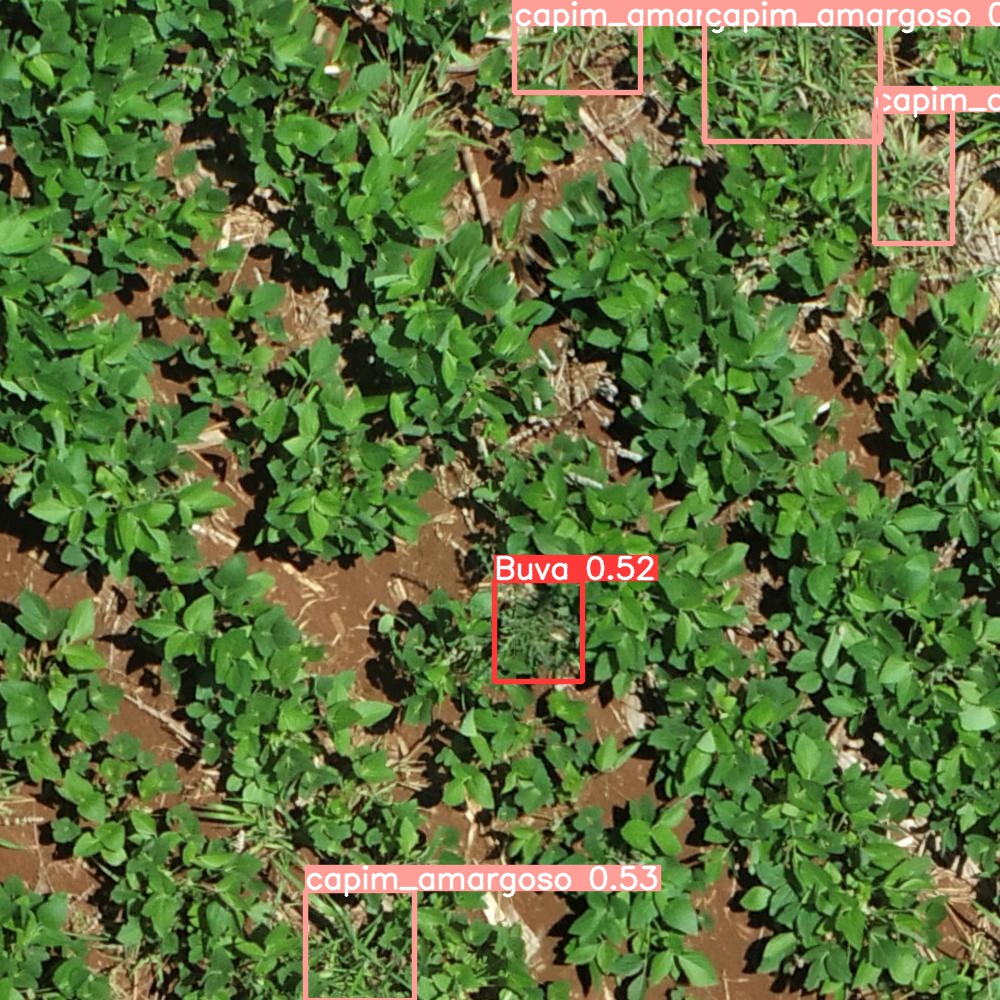

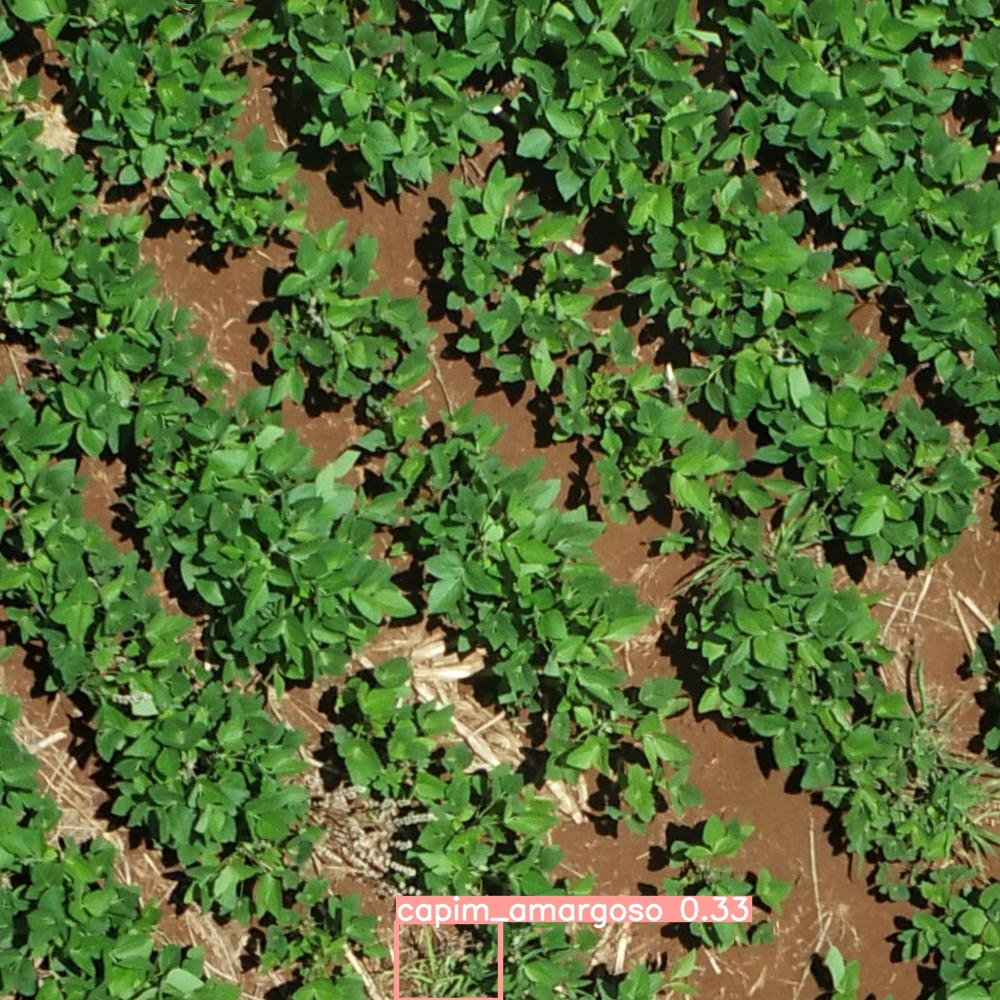

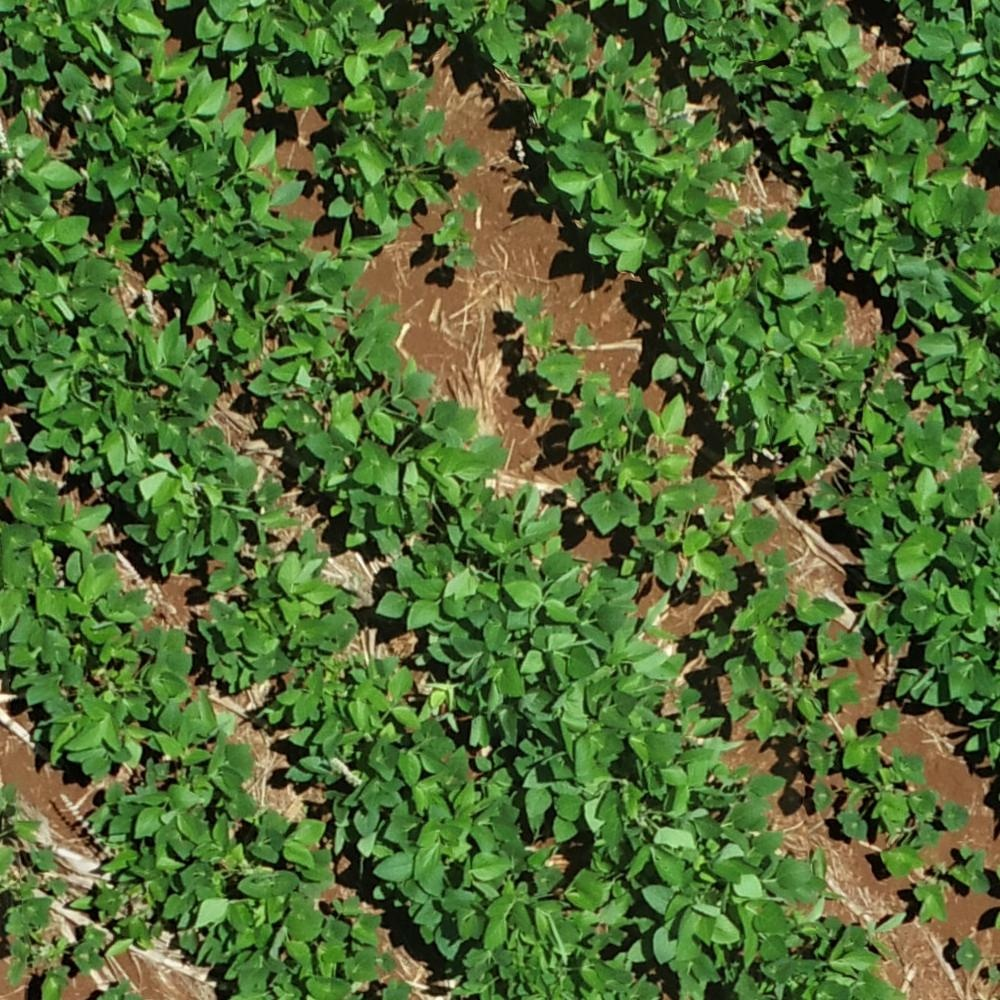

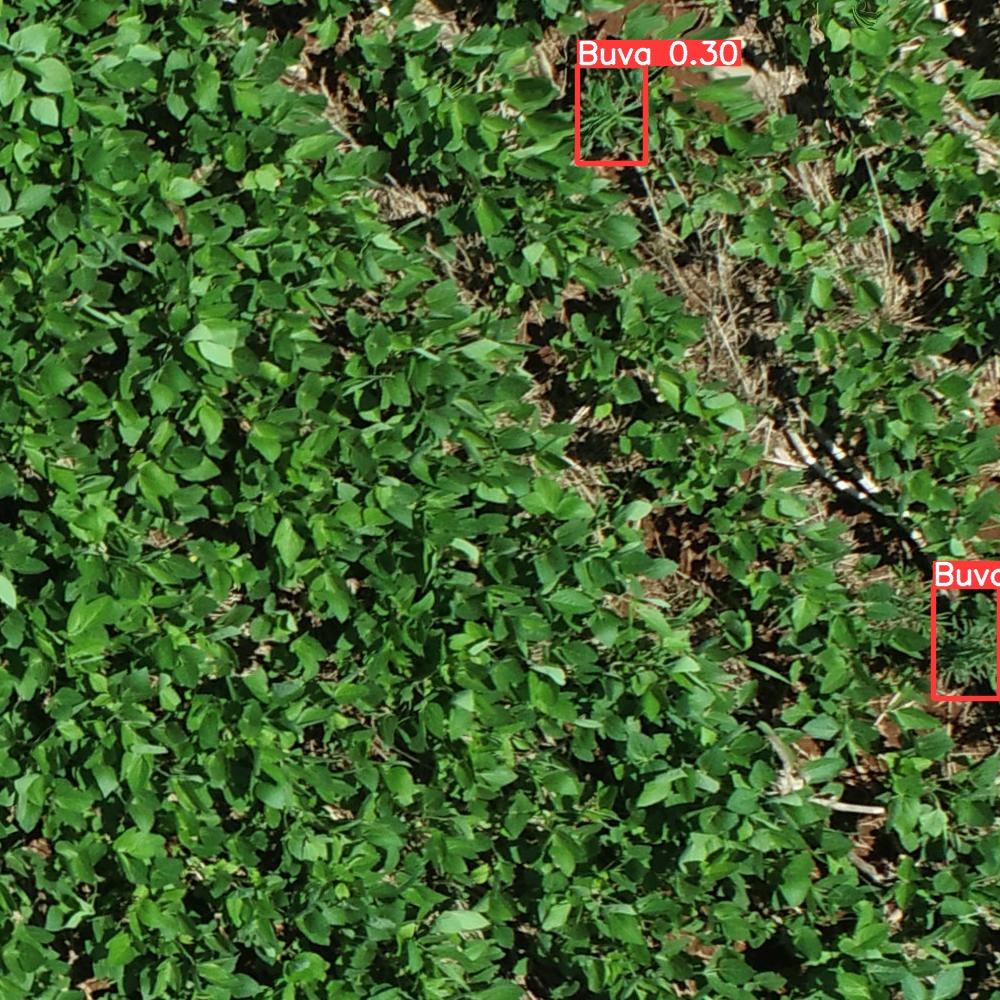

In [ ]:
for images in glob.glob('/content/yolov9/runs/detect/exp2/*.jpg')[0:5]:
    display(Image(filename=images))

Listamos todos os .txt e com a ajuda do rasterio convertemos as posições x e y em valores de latitude e longitude:

In [ ]:
ls_x = []
ls_y = []
ls_class = []
imgs_to_pred = [f for f in os.listdir('/content/yolov9/runs/detect/exp2/labels/') if f.endswith('.txt')]
for images in imgs_to_pred:
  filename = images.split('.')[0]
  src = rasterio.open('/content/Predict/' + filename + '.tif')
  path = f'/content/yolov9/runs/detect/exp2/labels/'+filename+'.txt'
  cols = ['class', 'x-center', 'y-center', 'x_extend', 'y_extend']
  df = pd.read_csv(path, sep=" ", header=None)
  df.columns = cols
  df['x-center'] = np.round(df['x-center'] * 1000)
  df['y-center'] = np.round(df['y-center'] * 1000)
  for i,row in df.iterrows():
    xs, ys = rasterio.transform.xy(src.transform, row['y-center'], row['x-center'])
    ls_x.append(xs)
    ls_y.append(ys)
    ls_class.append(row['class'])

In [ ]:
df_xy = pd.DataFrame([])
df_xy['x'] = ls_x
df_xy['y'] = ls_y
df_xy['class'] = ls_class

Criamos um geodataframe com os pontos centrais das detecções:

In [ ]:
gdf = gpd.GeoDataFrame(df_xy, geometry=gpd.points_from_xy(df_xy['x'], df_xy['y']))

In [ ]:
src_img.crs

CRS.from_epsg(31981)

In [ ]:
gdf = gdf.set_crs(src_img.crs.to_dict()['init'])

In [ ]:
gdf

,x,y,class,geometry
0,721321.490523,7.538871e+06,1.0,POINT (721321.491 7538870.720)
1,721321.436910,7.538873e+06,1.0,POINT (721321.437 7538872.859)
2,721321.607496,7.538873e+06,1.0,POINT (721321.607 7538872.547)
3,721349.876000,7.538910e+06,0.0,POINT (721349.876 7538909.643)
4,721349.861379,7.538910e+06,0.0,POINT (721349.861 7538909.818)
...,...,...,...,...
1524,721337.376935,7.538919e+06,0.0,POINT (721337.377 7538919.190)
1525,721337.311138,7.538917e+06,0.0,POINT (721337.311 7538917.416)
1526,721332.534735,7.538869e+06,1.0,POINT (721332.535 7538869.041)
1527,721342.604171,7.538909e+06,1.0,POINT (721342.604 7538909.167)


Assim podemos plotar os pontos juntos com a imagem original:

<Axes: >

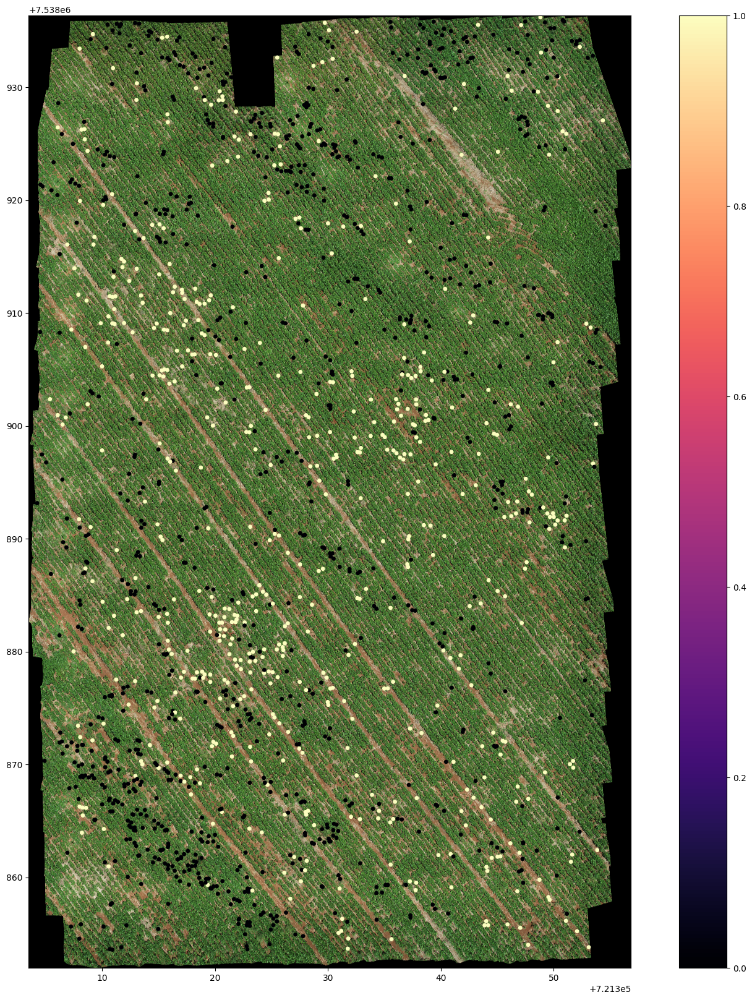

In [ ]:
fig, ax = plt.subplots(figsize=(20, 20))
show((src_img), ax=ax)
gdf.plot(ax=ax,  marker='o', column='class', cmap='magma', legend=True, markersize=15)

Por fim, podemos salvar esse geodataframe me um arquivo .geojson:

In [ ]:
gdf.to_file('/content/weeds-v3.json', driver="GeoJSON")